# Analysis of Youtube Trending Videos in the U.S. year 2020 - 2021

#### Table of Content
1. Context
2. Problem Statement
3. Set up
4. Exploratory Data Analysis
6. Machine Learning

## Context

YouTube maintains a list of the top trending videos on the platform. To determine Youtube's top-trending videos, YouTube uses a combination of factors including measuring users interactions (number of views, shares, comments and likes). You can learn more about how Youtube determines its trending video list [here](https://support.google.com/youtube/answer/7239739?hl=en) .

According to a study by H. Tankovska in early 2021, as of May 2019, more than 500 hours of video were uploaded to YouTube every minute. This equates to approximately 30,000 hours of newly uploaded content per hour. The amount of content on YouTube has increased dramatically as consumer’s appetites for online video has grown. In fact, the number of video content hours uploaded every 60 seconds grew by around 40 percent between 2014 and 2019.

## Problem statement
With this information, we took a deeper dive into the top trending videos in the U.S. between August 2020 and April 2021. We used Apache Spark to explore the data and gain insights into characteristics behind trending Youtube videos. We have also used Spark machine learning models to predict views using characteristics that can be controlled by the user uploading the video. The model can potentially be used by Youtube users who are uploading videos and predict the number of views they can receive on their videos.

## Set Up

### Importing libraries

Below are the libraries that were used in order to perform EDA (Exploratory data analysis) and Machine Learning using Spark. 

In [59]:
import pyspark
import pandas as pd
import numpy as np
import re
import requests
from pyspark.sql import SparkSession
from pyspark.sql.functions import col
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from matplotlib import pyplot as plt
import matplotlib.colors as mc
import seaborn as sns

from pyspark.sql.functions import *
from pyspark.sql.functions import unix_timestamp
from pyspark.sql.functions import hour
from pyspark.sql.functions import isnull, when, count, col
from pyspark.sql.functions import when
from pyspark.sql.functions import countDistinct

#ML Regression Packages
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml.regression import LinearRegression
#ML Evaluation Packages
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
#ML Data Preparation Packages
from pyspark.ml.feature import StringIndexer
from pyspark.ml.feature import VectorAssembler
#ML Classification Packages
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

from pyspark.ml.feature import Bucketizer
from pyspark.ml import Pipeline


### Launch Spark

In [60]:
pyspark.__version__

'3.1.1'

### Loading the dataset

In [61]:
spark = SparkSession \
    .builder \
    .appName('US_youtube_trending_data.csv') \
    .getOrCreate()

### Creating Spark session

In [62]:
spark

### Loading data into DataFrame

In [63]:
df = (spark.read
          .format("csv")
          .option('header', 'true')
          .load("US_youtube_trending_data.csv"))

In [64]:
df.show(5)

+-----------+--------------------+--------------------+--------------------+-------------+----------+--------------------+--------------------+----------+------+--------+-------------+--------------------+-----------------+----------------+
|   video_id|               title|         publishedAt|           channelId| channelTitle|categoryId|       trending_date|                tags|view_count| likes|dislikes|comment_count|      thumbnail_link|comments_disabled|ratings_disabled|
+-----------+--------------------+--------------------+--------------------+-------------+----------+--------------------+--------------------+----------+------+--------+-------------+--------------------+-----------------+----------------+
|3C66w5Z0ixs|I ASKED HER TO BE...|2020-08-11T19:20:14Z|UCvtRTOMP2TqYqu51...|     Brawadis|        22|2020-08-12T00:00:00Z|brawadis|prank|ba...|   1514614|156908|    5855|        35313|https://i.ytimg.c...|            FALSE|           FALSE|
|M9Pmf9AB4Mo|Apex Legends | St...|20

### Converting the DataFrame into Pandas

Since the DataFrame configuration is not in a cell format, we converted the DataFrame into panda to get a better look of the data.

In [65]:
df.toPandas().head(5)

,video_id,title,publishedAt,channelId,channelTitle,categoryId,trending_date,tags,view_count,likes,dislikes,comment_count,thumbnail_link,comments_disabled,ratings_disabled
0,3C66w5Z0ixs,I ASKED HER TO BE MY GIRLFRIEND...,2020-08-11T19:20:14Z,UCvtRTOMP2TqYqu51xNrqAzg,Brawadis,22,2020-08-12T00:00:00Z,brawadis|prank|basketball|skits|ghost|funny vi...,1514614,156908,5855,35313,https://i.ytimg.com/vi/3C66w5Z0ixs/default.jpg,FALSE,FALSE
1,M9Pmf9AB4Mo,Apex Legends | Stories from the Outlands – “Th...,2020-08-11T17:00:10Z,UC0ZV6M2THA81QT9hrVWJG3A,Apex Legends,20,2020-08-12T00:00:00Z,Apex Legends|Apex Legends characters|new Apex ...,2381688,146739,2794,16549,https://i.ytimg.com/vi/M9Pmf9AB4Mo/default.jpg,FALSE,FALSE
2,J78aPJ3VyNs,I left youtube for a month and THIS is what ha...,2020-08-11T16:34:06Z,UCYzPXprvl5Y-Sf0g4vX-m6g,jacksepticeye,24,2020-08-12T00:00:00Z,jacksepticeye|funny|funny meme|memes|jacksepti...,2038853,353787,2628,40221,https://i.ytimg.com/vi/J78aPJ3VyNs/default.jpg,FALSE,FALSE
3,kXLn3HkpjaA,XXL 2020 Freshman Class Revealed - Official An...,2020-08-11T16:38:55Z,UCbg_UMjlHJg_19SZckaKajg,XXL,10,2020-08-12T00:00:00Z,xxl freshman|xxl freshmen|2020 xxl freshman|20...,496771,23251,1856,7647,https://i.ytimg.com/vi/kXLn3HkpjaA/default.jpg,FALSE,FALSE
4,VIUo6yapDbc,Ultimate DIY Home Movie Theater for The LaBran...,2020-08-11T15:10:05Z,UCDVPcEbVLQgLZX0Rt6jo34A,Mr. Kate,26,2020-08-12T00:00:00Z,The LaBrant Family|DIY|Interior Design|Makeove...,1123889,45802,964,2196,https://i.ytimg.com/vi/VIUo6yapDbc/default.jpg,FALSE,FALSE


<h1>Exploratory Data Analysis</h1>

### Checking the data types of all columns
This step tells us the types of data we are working with, and can help us make informed decisions on how we want to use the data.

In [66]:
df.dtypes

[('video_id', 'string'),
 ('title', 'string'),
 ('publishedAt', 'string'),
 ('channelId', 'string'),
 ('channelTitle', 'string'),
 ('categoryId', 'string'),
 ('trending_date', 'string'),
 ('tags', 'string'),
 ('view_count', 'string'),
 ('likes', 'string'),
 ('dislikes', 'string'),
 ('comment_count', 'string'),
 ('thumbnail_link', 'string'),
 ('comments_disabled', 'string'),
 ('ratings_disabled', 'string')]

### Converting data types and including additonal columns

Some columns have their data types inaccurately registered by Spark so we converted them into accurate data types.Selecting data types also makes the Spark run faster. In this step, we have also included additional columns like "hour", "datediff" and "wordCount" to assist our analysis. Other columns "like view_count_log", "comment_count_log", "likes_log" were added as the data was found to be very skewed.

In [67]:
dataset = df.withColumn('publishedAt', unix_timestamp("publishedAt", '%Y-%m-%dT%H:%M:%S.%fZ')) #converting to date, hour and minutes

dataset = df.select(col('video_id').cast('string'),
                         col('title').cast('string'),
                         col('publishedAt').cast('timestamp'),
                         col('channelId').cast('string'),
                         col('channelTitle').cast('string'),
                         col('categoryId').cast('string'),
                         col('trending_date').cast('date'),
                         col('tags').cast('string'),
                         col('view_count').cast('int'),
                         col('likes').cast('int'),
                         col('dislikes').cast('int'),
                         col('comment_count').cast('int'),
                         col('thumbnail_link').cast('string'),
                         col('comments_disabled').cast('string'),
                         col('ratings_disabled').cast('string')
                        )
dataset = dataset.withColumn("hour", hour("publishedAt")) #hour at which video was published
dataset = dataset.withColumn("datediff", datediff(col('trending_date'),col("publishedAt"))) #number of days between trending date and video published date

dataset = dataset.withColumn("view_count_log", log('view_count')) #converting views to log
dataset = dataset.withColumn("comment_count_log", log1p("comment_count")) #using log1p as we want to keep 0 comments in the analysis
dataset = dataset.withColumn("likes_log", log1p("likes")) #using log1p as we want to keep 0 likes in the analysis

dataset = dataset.withColumn('wordCount', size(split(col('title'), ' '))) #counting the length of the title

Let's check out the result:

In [68]:
dataset.dtypes #checking datatype of final dataset

[('video_id', 'string'),
 ('title', 'string'),
 ('publishedAt', 'timestamp'),
 ('channelId', 'string'),
 ('channelTitle', 'string'),
 ('categoryId', 'string'),
 ('trending_date', 'date'),
 ('tags', 'string'),
 ('view_count', 'int'),
 ('likes', 'int'),
 ('dislikes', 'int'),
 ('comment_count', 'int'),
 ('thumbnail_link', 'string'),
 ('comments_disabled', 'string'),
 ('ratings_disabled', 'string'),
 ('hour', 'int'),
 ('datediff', 'int'),
 ('view_count_log', 'double'),
 ('comment_count_log', 'double'),
 ('likes_log', 'double'),
 ('wordCount', 'int')]

In [69]:
dataset.show(5)

+-----------+--------------------+-------------------+--------------------+-------------+----------+-------------+--------------------+----------+------+--------+-------------+--------------------+-----------------+----------------+----+--------+------------------+------------------+------------------+---------+
|   video_id|               title|        publishedAt|           channelId| channelTitle|categoryId|trending_date|                tags|view_count| likes|dislikes|comment_count|      thumbnail_link|comments_disabled|ratings_disabled|hour|datediff|    view_count_log| comment_count_log|         likes_log|wordCount|
+-----------+--------------------+-------------------+--------------------+-------------+----------+-------------+--------------------+----------+------+--------+-------------+--------------------+-----------------+----------------+----+--------+------------------+------------------+------------------+---------+
|3C66w5Z0ixs|I ASKED HER TO BE...|2020-08-11 15:20:14|UCvt

#### Summarizing data and converting results into pandas to get a better look of the result:

In [70]:
dataset.describe().toPandas()

,summary,video_id,title,channelId,channelTitle,categoryId,tags,view_count,likes,dislikes,comment_count,thumbnail_link,comments_disabled,ratings_disabled,hour,datediff,view_count_log,comment_count_log,likes_log,wordCount
0,count,52991,52991,52991,52991,52991,52991,52991,52991,52991,52991,52991,52991,52991,52991,52991,52965,52991,52991,52991
1,mean,None,None,None,None,18.61810496121983,None,2710755.2364552473,150445.41622162255,3395.891547621294,15568.596289936027,None,None,None,12.889056632258308,4.243324338095149,14.033052952454167,8.288682562422062,10.803081419229423,8.895586042912948
2,stddev,None,None,None,None,7.049763252708128,None,6167696.576334619,417781.47715530026,15523.585060560985,104314.12565911695,None,None,None,5.772991831336436,2.3714927062655975,1.1453274961229554,1.844483739556252,1.6791442891251112,3.6649837154565805
3,min,#NAME?,!@#$%$#!! || Dubov vs Carlsen || Airthings Mas...,UC-2MJlKSq9_pYk5-bdvMhnw,#TeamTrees,1,#1 overall|49ers|BYU|Chris Brockman|Clemson|Da...,0,0,0,0,https://i.ytimg.com/vi/--SvHNpSvpk/default.jpg,FALSE,FALSE,0,0,10.558673226808954,0.0,0.0,1
4,max,zziBybeSAtw,🤯 LATE COMEBACK DRAMA! | HIGHLIGHTS | Granada ...,UCzznO4xSV8BKnUBPyswtCUw,채널 NCT DANCE,29,현아|HyunA|ImNotCool|엠카운트다운|엠카|MCD|MCOUNTDOWN|엠넷...,232649205,15735533,879354,6065230,https://i.ytimg.com/vi/zziBybeSAtw/default.jpg,TRUE,TRUE,23,36,19.265042319098868,15.618083187021625,16.57143202498773,23


### Checking for Null values

Most of the columns do not have null values. Only "view_count_log" column have 26 null values. We will be removing this rows in the later analysis

In [71]:
dataset.select([count(when(isnull(c), c)).alias(c) for c in dataset.columns]).show()

+--------+-----+-----------+---------+------------+----------+-------------+----+----------+-----+--------+-------------+--------------+-----------------+----------------+----+--------+--------------+-----------------+---------+---------+
|video_id|title|publishedAt|channelId|channelTitle|categoryId|trending_date|tags|view_count|likes|dislikes|comment_count|thumbnail_link|comments_disabled|ratings_disabled|hour|datediff|view_count_log|comment_count_log|likes_log|wordCount|
+--------+-----+-----------+---------+------------+----------+-------------+----+----------+-----+--------+-------------+--------------+-----------------+----------------+----+--------+--------------+-----------------+---------+---------+
|       0|    0|          0|        0|           0|         0|            0|   0|         0|    0|       0|            0|             0|                0|               0|   0|       0|            26|                0|        0|        0|
+--------+-----+-----------+---------+------

### Statistical summary of numerical columns
This method is used for pulling a statistical summary, such as count, mean, standard deviation, minimum, and maximum values of all numerical data in the DataFrame.

In [72]:
dataset.select('comment_count','view_count','likes','dislikes', 'hour', 'datediff', 'view_count_log', 'comment_count_log','likes_log', 'wordCount').describe().toPandas()

,summary,comment_count,view_count,likes,dislikes,hour,datediff,view_count_log,comment_count_log,likes_log,wordCount
0,count,52991,52991,52991,52991,52991,52991,52965,52991,52991,52991
1,mean,15568.596289936027,2710755.2364552473,150445.41622162255,3395.891547621294,12.889056632258308,4.243324338095149,14.033052952454167,8.288682562422062,10.803081419229423,8.895586042912948
2,stddev,104314.12565911695,6167696.576334619,417781.47715530026,15523.585060560985,5.772991831336436,2.3714927062655975,1.1453274961229554,1.844483739556252,1.6791442891251112,3.6649837154565805
3,min,0,0,0,0,0,0,10.558673226808954,0.0,0.0,1
4,max,6065230,232649205,15735533,879354,23,36,19.265042319098868,15.618083187021625,16.57143202498773,23


The category of trending videos in this DataFrame is characterized by the ID as seen below.

In [73]:
dataset.select("categoryId").distinct().show(truncate=False)

+----------+
|categoryId|
+----------+
|15        |
|29        |
|22        |
|28        |
|27        |
|17        |
|26        |
|19        |
|23        |
|25        |
|24        |
|1         |
|20        |
|10        |
|2         |
+----------+



### Transforming categoryId to categoryName
To properly identify each category, we transform the categoryID to correspond with its respective name. For example, categoryID = 1 represents 'Film Animation'. After we transform the category column, we then removed the categoryID column.

In [74]:
df_Main = dataset.withColumn("categoryName", when(dataset.categoryId == "1","Film & Animation")
                                 .when(dataset.categoryId == "2","Autos & Vehiclese")
                                 .when(dataset.categoryId == "10","Music")
                                 .when(dataset.categoryId == "15","Pets & Animals")
                                 .when(dataset.categoryId == "17","Sports")
                                 .when(dataset.categoryId == "19","Travel & Events")
                                 .when(dataset.categoryId == "20","Gaming")
                                 .when(dataset.categoryId == "22","People & Blogs")
                                 .when(dataset.categoryId == "23","Comedy")
                                 .when(dataset.categoryId == "24","Entertainment")
                                 .when(dataset.categoryId == "25","News & Politics")
                                 .when(dataset.categoryId == "26","Howto & Style")
                                 .when(dataset.categoryId == "27","Education")
                                 .when(dataset.categoryId == "28","Science & Technology")
                                 .when(dataset.categoryId == "29","Nonprofits & Activisme")
                                 .when(dataset.categoryId.isNull() ,"")
                                 .otherwise(dataset.categoryId))

df_Main.select("categoryName").distinct().show(truncate=False)

+----------------------+
|categoryName          |
+----------------------+
|Education             |
|Nonprofits & Activisme|
|Gaming                |
|Entertainment         |
|Travel & Events       |
|Science & Technology  |
|Sports                |
|Howto & Style         |
|Film & Animation      |
|People & Blogs        |
|News & Politics       |
|Pets & Animals        |
|Autos & Vehiclese     |
|Music                 |
|Comedy                |
+----------------------+



Then, we take a final look of the DataFrame.

In [75]:
df_Main.toPandas().head(5)

,video_id,title,publishedAt,channelId,channelTitle,categoryId,trending_date,tags,view_count,likes,...,thumbnail_link,comments_disabled,ratings_disabled,hour,datediff,view_count_log,comment_count_log,likes_log,wordCount,categoryName
0,3C66w5Z0ixs,I ASKED HER TO BE MY GIRLFRIEND...,2020-08-11 15:20:14,UCvtRTOMP2TqYqu51xNrqAzg,Brawadis,22,2020-08-12,brawadis|prank|basketball|skits|ghost|funny vi...,1514614,156908,...,https://i.ytimg.com/vi/3C66w5Z0ixs/default.jpg,FALSE,FALSE,15,1,14.230671,10.472035,11.963421,7,People & Blogs
1,M9Pmf9AB4Mo,Apex Legends | Stories from the Outlands – “Th...,2020-08-11 13:00:10,UC0ZV6M2THA81QT9hrVWJG3A,Apex Legends,20,2020-08-12,Apex Legends|Apex Legends characters|new Apex ...,2381688,146739,...,https://i.ytimg.com/vi/M9Pmf9AB4Mo/default.jpg,FALSE,FALSE,13,1,14.683320,9.714141,11.896418,10,Gaming
2,J78aPJ3VyNs,I left youtube for a month and THIS is what ha...,2020-08-11 12:34:06,UCYzPXprvl5Y-Sf0g4vX-m6g,jacksepticeye,24,2020-08-12,jacksepticeye|funny|funny meme|memes|jacksepti...,2038853,353787,...,https://i.ytimg.com/vi/J78aPJ3VyNs/default.jpg,FALSE,FALSE,12,1,14.527898,10.602169,12.776453,11,Entertainment
3,kXLn3HkpjaA,XXL 2020 Freshman Class Revealed - Official An...,2020-08-11 12:38:55,UCbg_UMjlHJg_19SZckaKajg,XXL,10,2020-08-12,xxl freshman|xxl freshmen|2020 xxl freshman|20...,496771,23251,...,https://i.ytimg.com/vi/kXLn3HkpjaA/default.jpg,FALSE,FALSE,12,1,13.115884,8.942199,10.054146,8,Music
4,VIUo6yapDbc,Ultimate DIY Home Movie Theater for The LaBran...,2020-08-11 11:10:05,UCDVPcEbVLQgLZX0Rt6jo34A,Mr. Kate,26,2020-08-12,The LaBrant Family|DIY|Interior Design|Makeove...,1123889,45802,...,https://i.ytimg.com/vi/VIUo6yapDbc/default.jpg,FALSE,FALSE,11,1,13.932306,7.694848,10.732105,9,Howto & Style


<h2>Total number of videos</h2>

In [76]:
df_Main.count()

52991

<h2>Number of unique videos</h2>

In [77]:
df_Main.select(countDistinct("video_id")).show()

+------------------------+
|count(DISTINCT video_id)|
+------------------------+
|                    9038|
+------------------------+



## Correlation analysis and heatmap
We visualized the correlation between different parameters. Comments, dislikes, likes are found to be highly correlated to video views which is not surprising as the more views a video gets, there is more possibility of the video receiving more social interactions.

In [78]:
DF_DUMMY = df_Main.toPandas()
DF_DUMMY.corr()

,view_count,likes,dislikes,comment_count,hour,datediff,view_count_log,comment_count_log,likes_log,wordCount
view_count,1.000000,0.864737,0.711494,0.675278,-0.079084,0.194113,0.641411,0.358506,0.425216,-0.053925
likes,0.864737,1.000000,0.687992,0.785222,-0.072424,0.085896,0.521933,0.412541,0.476072,-0.099063
dislikes,0.711494,0.687992,1.000000,0.645867,-0.054300,0.086478,0.338872,0.228054,0.254974,-0.028730
comment_count,0.675278,0.785222,0.645867,1.000000,-0.017223,0.028850,0.258113,0.250712,0.221101,-0.040898
hour,-0.079084,-0.072424,-0.054300,-0.017223,1.000000,0.073434,-0.073948,-0.048227,-0.076901,-0.027571
datediff,0.194113,0.085896,0.086478,0.028850,0.073434,1.000000,0.281651,0.063202,0.115138,-0.005510
view_count_log,0.641411,0.521933,0.338872,0.258113,-0.073948,0.281651,1.000000,0.541897,0.679987,-0.093724
comment_count_log,0.358506,0.412541,0.228054,0.250712,-0.048227,0.063202,0.541897,1.000000,0.627150,-0.136784
likes_log,0.425216,0.476072,0.254974,0.221101,-0.076901,0.115138,0.679987,0.627150,1.000000,-0.204761
wordCount,-0.053925,-0.099063,-0.028730,-0.040898,-0.027571,-0.005510,-0.093724,-0.136784,-0.204761,1.000000


<AxesSubplot:>

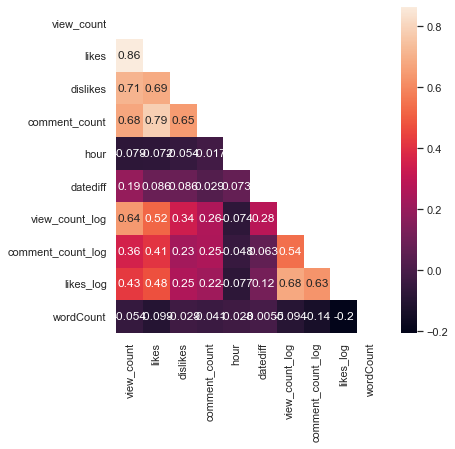

In [79]:
fig, ax = plt.subplots(figsize=(6, 6)) 
mask = np.zeros_like(DF_DUMMY.corr())
mask[np.triu_indices_from(mask)] = 1
sns.heatmap(DF_DUMMY.corr(), mask= mask, ax= ax, annot= True)

### Correlation between views and likes

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


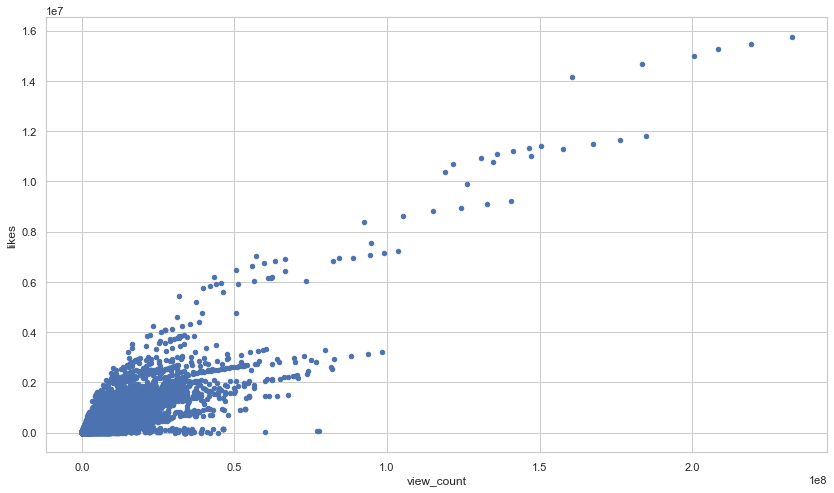

In [80]:
ax = DF_DUMMY.plot(kind='scatter', x='view_count', y='likes', figsize=(14,8))

<h2>Trending Videos and Views</h2>
<h3>Minimum view count of a trending video</h3>

In [81]:
df_Main.agg({'view_count': 'min'}).show() # there are videos with zero views

+---------------+
|min(view_count)|
+---------------+
|              0|
+---------------+



### Number of trending videos with 0 (zero) view count

Only 26 videos have zero views

In [82]:
df_Main.filter(df_Main.view_count == 0).count()

26

### Maximum view count of a trending video

The maximum number of views in a video is 232649205

In [83]:
df_Main.agg({'view_count': 'max'}).show()

+---------------+
|max(view_count)|
+---------------+
|      232649205|
+---------------+



The video is from BTS!

In [84]:
df_Main.filter(df_Main.view_count == 232649205).toPandas()

,video_id,title,publishedAt,channelId,channelTitle,categoryId,trending_date,tags,view_count,likes,...,thumbnail_link,comments_disabled,ratings_disabled,hour,datediff,view_count_log,comment_count_log,likes_log,wordCount,categoryName
0,gdZLi9oWNZg,BTS (방탄소년단) 'Dynamite' Official MV,2020-08-20 23:58:10,UC3IZKseVpdzPSBaWxBxundA,Big Hit Labels,10,2020-08-28,BIGHIT|빅히트|방탄소년단|BTS|BANGTAN|방탄,232649205,15735533,...,https://i.ytimg.com/vi/gdZLi9oWNZg/default.jpg,FALSE,FALSE,23,8,19.265042,15.618083,16.571432,5,Music


### View count distribution
Based on the below graph, it showed that video views is very skewed

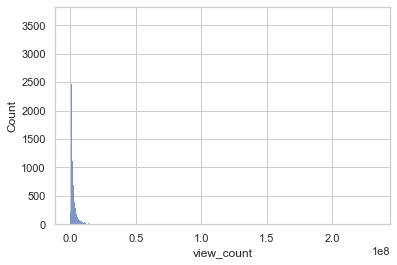

In [85]:
sns.set_theme(style="whitegrid")
df_Dummy = df_Main.select("view_count").toPandas()
ax = sns.histplot(x=df_Dummy['view_count']) #histogram of video views

### View count based on category
Music is the has the highest view count at about 49 million from all categories, followed by Entertainment and Gaming, while Nonprofits & Activism has the lowest view count.

In [86]:
df_Main.createOrReplaceTempView("YT_Data")
spark.sql("select categoryName,sum(view_count) Total_View from YT_Data \
          group by categoryName ORDER BY sum(view_count) desc").show(truncate=False)

+----------------------+-----------+
|categoryName          |Total_View |
+----------------------+-----------+
|Music                 |49608723248|
|Entertainment         |28640901805|
|Gaming                |18958853006|
|Sports                |11605344744|
|People & Blogs        |10195523703|
|Science & Technology  |6286576615 |
|Film & Animation      |4353200121 |
|Comedy                |4033999870 |
|News & Politics       |3812392790 |
|Howto & Style         |3133985068 |
|Education             |1383348582 |
|Autos & Vehiclese     |1100550005 |
|Pets & Animals        |370296727  |
|Travel & Events       |113870468  |
|Nonprofits & Activisme|48063983   |
+----------------------+-----------+



### Number of days a trending video lasted (a video can be trending for more than 1 day)
Some videos may be trending for days at a time on Youtube, which generates a number of view count. Below are a list of the top 20 videos that were trending for more than a day on the platform between August 2020 and April 2021.

In [87]:
df_Main.createOrReplaceTempView("YT_Data")
spark.sql("select title,count(distinct video_id),sum(view_count) Total_View from YT_Data \
          group by title ORDER BY count(distinct video_id) desc,sum(view_count)").show(truncate=False)

+--------------------------------------------------------------------------------------------------+------------------------+----------+
|title                                                                                             |count(DISTINCT video_id)|Total_View|
+--------------------------------------------------------------------------------------------------+------------------------+----------+
|Starlink Mission                                                                                  |15                      |70373877  |
|We Broke Up                                                                                       |4                       |45050462  |
|Creative People On Another Level                                                                  |4                       |100499120 |
|$1000 if You Can Break This Ball in 1 Minute                                                      |3                       |16098628  |
|we broke up                             

### Number of video trending based on category
Next, we break down the trending video category based on the number of videos owned by a unique channel. Based on the data, NBA tops other channel at 108 videos that were trending. Despite being at 4th place in terms of view count, Sports as a category tops the total number of trending videos between August 2020 and April 2021.

In [88]:
df_Main.createOrReplaceTempView("YT_Data")
spark.sql("select categoryName, channelTitle,count(distinct video_id)  from YT_Data \
          group by categoryName, channelTitle ORDER BY count(distinct video_id) desc").show(truncate=False)

+--------------------+------------------------------------+------------------------+
|categoryName        |channelTitle                        |count(DISTINCT video_id)|
+--------------------+------------------------------------+------------------------+
|Sports              |NBA                                 |108                     |
|Sports              |NFL                                 |105                     |
|Sports              |ESPN                                |44                      |
|Sports              |Champions League on CBS Sports      |43                      |
|Gaming              |MrBeast Gaming                      |41                      |
|Entertainment       |Saturday Night Live                 |37                      |
|Science & Technology|SpaceX                              |36                      |
|Entertainment       |SSSniperWolf                        |33                      |
|Entertainment       |MrBeast                             |29    

### Maximum number of likes of a trending video
The video has around 15 million likes and appears to be the same video with the highest number of view count.

In [89]:
df_dummy = df_Main.agg({'likes': 'max'}).show()
df_Main.filter(df_Main.likes == 15735533).toPandas()

+----------+
|max(likes)|
+----------+
|  15735533|
+----------+



,video_id,title,publishedAt,channelId,channelTitle,categoryId,trending_date,tags,view_count,likes,...,thumbnail_link,comments_disabled,ratings_disabled,hour,datediff,view_count_log,comment_count_log,likes_log,wordCount,categoryName
0,gdZLi9oWNZg,BTS (방탄소년단) 'Dynamite' Official MV,2020-08-20 23:58:10,UC3IZKseVpdzPSBaWxBxundA,Big Hit Labels,10,2020-08-28,BIGHIT|빅히트|방탄소년단|BTS|BANGTAN|방탄,232649205,15735533,...,https://i.ytimg.com/vi/gdZLi9oWNZg/default.jpg,FALSE,FALSE,23,8,19.265042,15.618083,16.571432,5,Music


### Number of likes based on category
Based on category, Music accumulates the most number of likes, as shown by the top trending video from the previous EDA, while Travel & Events has the least number of likes out of all category.

In [90]:
df_Main.groupby('categoryName').agg({'likes': 'max'}).show()

+--------------------+----------+
|        categoryName|max(likes)|
+--------------------+----------+
|           Education|    376802|
|Nonprofits & Acti...|    230317|
|              Gaming|   2591056|
|       Entertainment|   3871379|
|     Travel & Events|     49693|
|Science & Technology|   1733986|
|              Sports|   1107372|
|       Howto & Style|    678786|
|    Film & Animation|    961910|
|      People & Blogs|   2748677|
|     News & Politics|    634058|
|      Pets & Animals|    247479|
|   Autos & Vehiclese|   1368171|
|               Music|  15735533|
|              Comedy|   1914930|
+--------------------+----------+



### Date and category of least and most trending videos
We also look at the number of trending videos and the category from the lowest to the highest count.

In [91]:
df_Main.createOrReplaceTempView("YT_Data")
df_Dummy = spark.sql("select categoryName, trending_date, count(distinct video_id)  from YT_Data \
          group by categoryName, trending_date ORDER BY count(distinct video_id) desc").toPandas()
df_Dummy.tail(1)

,categoryName,trending_date,count(DISTINCT video_id)
3514,Pets & Animals,2020-09-04,1


In [92]:
df_Dummy.head(1)

,categoryName,trending_date,count(DISTINCT video_id)
0,Music,2020-11-24,65


### Analysis of most commonly used Title
We identify the most common title used in trending videos, and the result shows that "Official Video" is most commonly used as part of the video title.

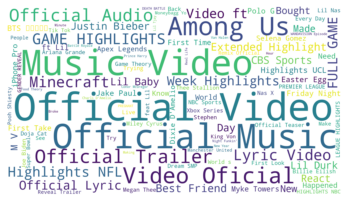

In [93]:
# Create stopword list:
stopwords = set(STOPWORDS)
stopwords.update(["drink", "now", "wine", "flavor", "flavors"])

DF_Dummy = df_Main.toPandas()
text = " ".join(review for review in DF_Dummy.title)
wordcloud = WordCloud(stopwords=stopwords, width=1920, height=1080, max_words=100, background_color="white").generate(text)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

### Analysis of most commonly used Tag
Aside from the title, we also analyze the most common tags used in trending videos. 'among us', 'music', and 'tik tok' are some of the most commonly used tags in trending videos.

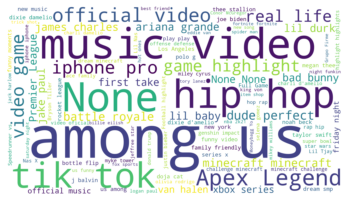

In [94]:
text = " ".join(review for review in DF_Dummy.tags)

wordcloud = WordCloud(stopwords=stopwords, width=1920, height=1080, max_words=100, background_color="white").generate(text)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

Some of the videos have zero views. The number was very low so we removed it.

In [95]:
DF_DUMMY = DF_DUMMY.loc[DF_DUMMY["view_count"] != 0]

In [96]:
df_Main = df_Main.where("view_count != 0")

The number of trending videos based on likes is skewed as seen in below graph.

<AxesSubplot:>

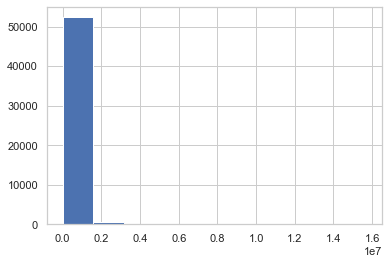

In [46]:
DF_DUMMY['likes'].hist() 

Likewise, the number of trending videos based on the comments count is skewed as seen in below graph.

<AxesSubplot:>

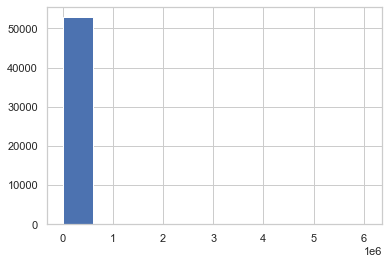

In [47]:
DF_DUMMY['comment_count'].hist()

Some trending videos have their comments section disabled, but the majority of trending videos have their comments section enabled, meaning that viewers can still leave comments on the video.

<AxesSubplot:title={'center':'view_count'}, xlabel='comments_disabled'>

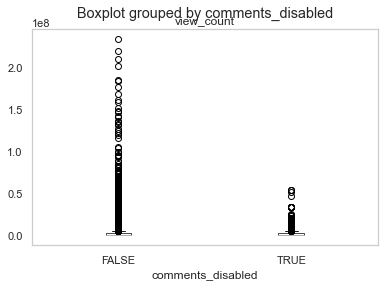

In [48]:
DF_DUMMY.boxplot(by = 'comments_disabled', column=['view_count'], grid = False) 

<AxesSubplot:title={'center':'likes'}, xlabel='comments_disabled'>

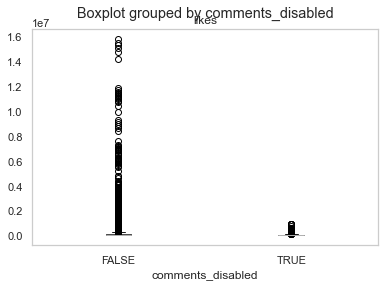

In [46]:
DF_DUMMY.boxplot(by = 'comments_disabled', column=['likes'], grid = False) #same trend for likes. 

Other trending videos can also have their ratings disabled, but the majority of trending videos have their ratings section enabled, meaning that viewers can still view the video's rating.

<AxesSubplot:title={'center':'view_count'}, xlabel='ratings_disabled'>

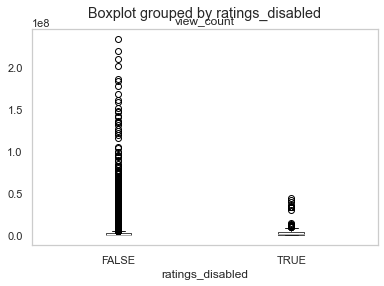

In [49]:
DF_DUMMY.boxplot(by = 'ratings_disabled', column=['view_count'], grid = False)

<AxesSubplot:title={'center':'likes'}, xlabel='ratings_disabled'>

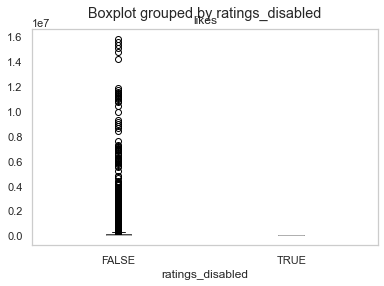

In [48]:
DF_DUMMY.boxplot(by = 'ratings_disabled', column=['likes'], grid = False) # same trend for likes

As views were skewed, we decided to use log transformation on the number of views. After using log, it is normally distributed as shown in the histogram below.

<AxesSubplot:>

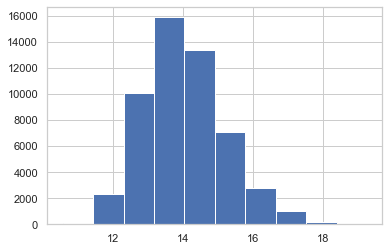

In [50]:
DF_DUMMY['view_count_log'].hist()

Same applied to likes. It is still little skewed. 

<AxesSubplot:>

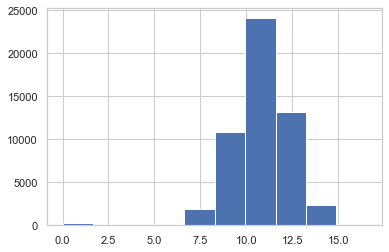

In [52]:
DF_DUMMY['likes_log'].hist()

Same applied to comments.

<AxesSubplot:>

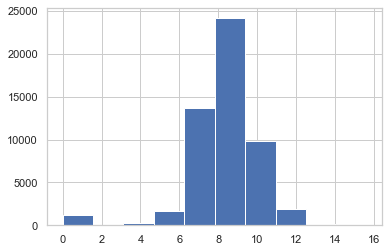

In [53]:
DF_DUMMY['comment_count_log'].hist()

### Most videos become trending within 5 days from the published date

<AxesSubplot:>

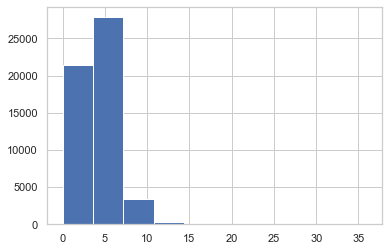

In [54]:
DF_DUMMY['datediff'].hist()

### Oddly high number of trending videos
There were two periods between August 2020 and April 2021 where there were siginificantly higher number of trending videos, which occured within the month of February and March 2021. Approximately 400 videos were trending during these times, as opposed to the usual ~200 videos.

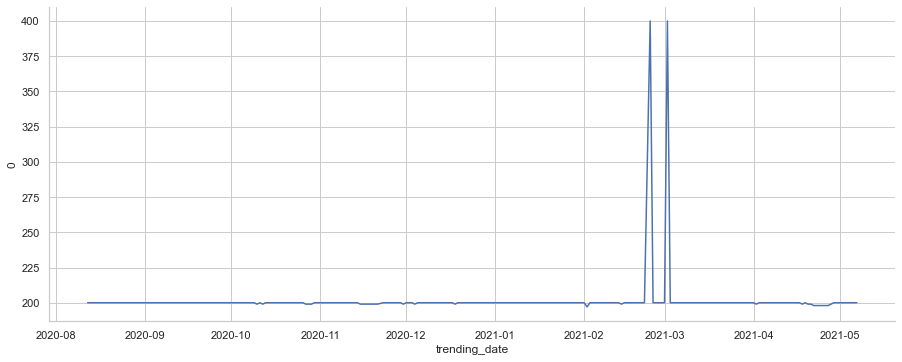

In [55]:
#finding number of daily trending videos for each day
daily = DF_DUMMY[['trending_date']].value_counts().reset_index().sort_values(by='trending_date').reset_index(drop=True)
sns.relplot(data=daily, x='trending_date', y=0,kind='line', aspect=2.5)

### Most of the trending videos were published around noon local time
Another interesting find is that the majority of trending videos were published around midday local time, which might also be the time of the day where there were most traffic on Youtube for domestic viewers.

<AxesSubplot:xlabel='hour', ylabel='0'>

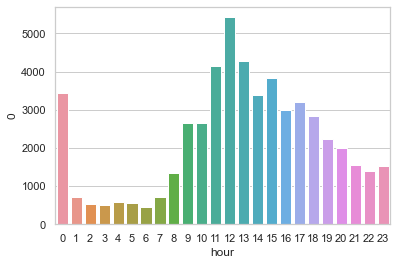

In [56]:
published_hour = DF_DUMMY[['hour']].value_counts().reset_index().sort_values(by='hour').reset_index(drop=True)
sns.barplot(data=published_hour, x='hour', y=0)

### Most of the trending videos fall into categories Music and Entertainment

<AxesSubplot:xlabel='categoryName', ylabel='0'>

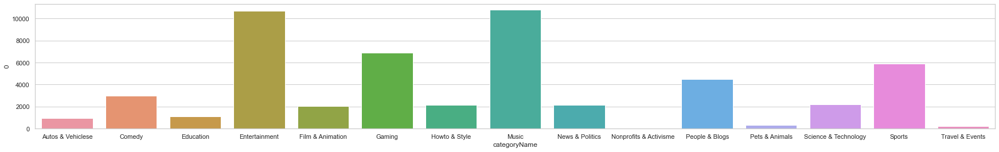

In [57]:
fig_dims = (30, 4)
fig, ax = plt.subplots(figsize=fig_dims)

category = DF_DUMMY[['categoryName']].value_counts().reset_index().sort_values(by='categoryName').reset_index(drop=True)
sns.barplot(data=category, x='categoryName', y=0, ax = ax)

### Range in trending video view counts
We look at the range of view counts between each video category. Both Music and Entertainment also had the largest range in video views.

<AxesSubplot:xlabel='categoryName', ylabel='view_count'>

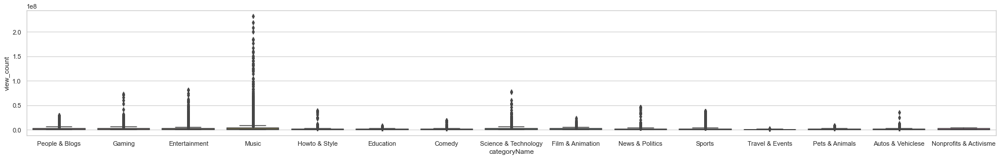

In [59]:
fig_dims = (30, 4)
fig, ax = plt.subplots(figsize=fig_dims)
sns.boxplot(y='view_count', x='categoryName', data=DF_DUMMY, ax = ax)

As it was hard to see the distribution, we also used log view for this analysis.

<AxesSubplot:xlabel='categoryName', ylabel='view_count_log'>

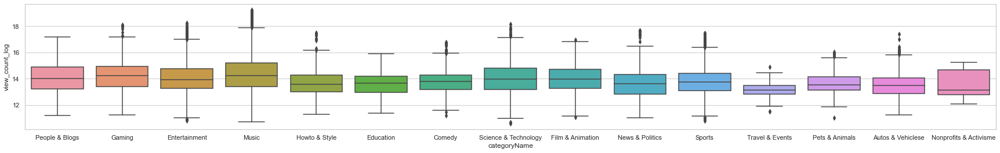

In [60]:
fig_dims = (30, 4)
fig, ax = plt.subplots(figsize=fig_dims)
sns.boxplot(y='view_count_log', x='categoryName', data=DF_DUMMY, ax = ax)

### Length of trending video title
The title length of a trending video may be affecting the number of view counts. According to below graph, we see that videos with titles that have between 5-12 words tend have higher view counts compared to those with lesser or more words. This is also proven by the number of likes, where videos with titles that have between 5-12 words tend to have more likes.

<AxesSubplot:xlabel='wordCount', ylabel='view_count'>

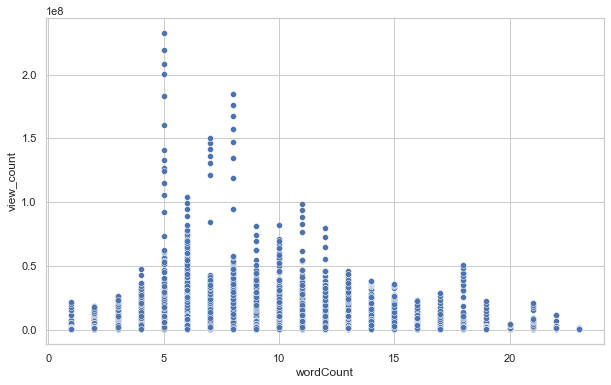

In [61]:
fig_dims = (10, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.scatterplot(y='view_count', x='wordCount', data=DF_DUMMY, ax = ax)

<AxesSubplot:xlabel='wordCount', ylabel='likes'>

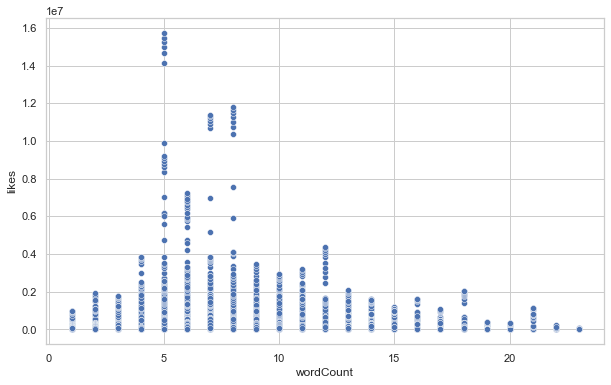

In [62]:
fig_dims = (10, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.scatterplot(y='likes', x='wordCount', data=DF_DUMMY, ax = ax)

## Machine Learning

We will be using machine learning model to predict for video views. We tested with Random Forest Regression model and Linear regression model. We also tested with Random Forest Classifier model.

#### Converting columns to binary values:

We would like to include "comments_disabled" and "rating_disabled" into our ML model. To include them, we would first need to convert them into binary values. 

In [97]:
#creating new comments_disabled_binary column
df_Main = StringIndexer(
    inputCol='comments_disabled', 
    outputCol='comments_disabled_binary', 
    handleInvalid='keep').fit(df_Main).transform(df_Main)

#creating new ratings_disabled_binary column
df_Main = StringIndexer(
    inputCol='ratings_disabled', 
    outputCol='ratings_disabled_binary', 
    handleInvalid='keep').fit(df_Main).transform(df_Main)

#### Checking the data types of all columns:

In [39]:
df_Main.dtypes

[('video_id', 'string'),
 ('title', 'string'),
 ('publishedAt', 'timestamp'),
 ('channelId', 'string'),
 ('channelTitle', 'string'),
 ('categoryId', 'string'),
 ('trending_date', 'date'),
 ('tags', 'string'),
 ('view_count', 'int'),
 ('likes', 'int'),
 ('dislikes', 'int'),
 ('comment_count', 'int'),
 ('thumbnail_link', 'string'),
 ('comments_disabled', 'string'),
 ('ratings_disabled', 'string'),
 ('hour', 'int'),
 ('datediff', 'int'),
 ('view_count_log', 'double'),
 ('comment_count_log', 'double'),
 ('likes_log', 'double'),
 ('wordCount', 'int'),
 ('categoryName', 'string'),
 ('comments_disabled_binary', 'double'),
 ('ratings_disabled_binary', 'double')]

#### Dropping all the columns that are irrelevant for the analyses:

In [40]:
df_Main = df_Main.drop('ratings_disabled')
df_Main = df_Main.drop('comments_disabled')
df_Main = df_Main.drop('thumbnail_link')
df_Main = df_Main.drop('channelId')
df_Main = df_Main.drop('channelTitle')

#### Assembling all the features with VectorAssembler

The model will using features that can controlled by the user to predict for view views. Comment disabled, ratings disabled, word count, and published hour were included as features for the model. 

In [109]:
required_features = ['comments_disabled_binary',
                    'ratings_disabled_binary',
                    'wordCount',
                    'hour']

assembler = VectorAssembler(inputCols=required_features, outputCol='features')
transformed_data = assembler.transform(df_Main)

This has created a new column called "features" in the "transformed_data" datafram below:

In [71]:
transformed_data.show(5)

+-----------+--------------------+-------------------+----------+-------------+--------------------+----------+------+--------+-------------+----+--------+------------------+------------------+------------------+---------+--------------+------------------------+-----------------------+-------------------+
|   video_id|               title|        publishedAt|categoryId|trending_date|                tags|view_count| likes|dislikes|comment_count|hour|datediff|    view_count_log| comment_count_log|         likes_log|wordCount|  categoryName|comments_disabled_binary|ratings_disabled_binary|           features|
+-----------+--------------------+-------------------+----------+-------------+--------------------+----------+------+--------+-------------+----+--------+------------------+------------------+------------------+---------+--------------+------------------------+-----------------------+-------------------+
|3C66w5Z0ixs|I ASKED HER TO BE...|2020-08-11 15:20:14|        22|   2020-08-12|

#### Splitting data between testing and training:

In order to do ML models, we need to split the datafram into test and train data. 

In [110]:
(training_data, test_data) = transformed_data.randomSplit([0.8,0.2])

### ML: Random Forest Regression Model


In this selection, we  showed how we tested with Random Forest Regression Model. 

In [121]:
rf = RandomForestRegressor(labelCol='view_count', 
                            featuresCol='features',
                            maxDepth=5)

#### Fitting the model:

In [122]:
model = rf.fit(training_data)

In [123]:
predictions = model.transform(test_data)

#### Evaluating the model:

As this is a regression model, we will be RMSE and R^2 to evaluate the model. Ideally, you would like the RMSE to be low and R^2 to be close to 1. 

In [124]:
evaluator = RegressionEvaluator(
    labelCol='view_count', 
    predictionCol='prediction', 
    metricName='rmse')
RMSE = evaluator.evaluate(predictions)
print("RMSE on test data = %g" %RMSE)

RMSE on test data = 6.94448e+06


In [125]:
pred_evaluator = RegressionEvaluator(predictionCol="prediction", 
                 labelCol="view_count",metricName="r2")
print("R Squared (R2) on test data = %g" % pred_evaluator.evaluate(predictions))

R Squared (R2) on test data = 0.0387524


### ML: Random Forest Regression Model LogView

As the view values are very skewed, we used logview for the Random Forest Model. We used the same steps as mentioned before.

In [116]:
#Log View
rf_log = RandomForestRegressor(labelCol='view_count_log', 
                            featuresCol='features',
                            maxDepth=5)

In [117]:
model_log = rf_log.fit(training_data)

In [118]:
predictions_log = model_log.transform(test_data)

In [119]:
evaluator = RegressionEvaluator(
    labelCol='view_count_log', 
    predictionCol='prediction', 
    metricName='rmse')
RMSE = evaluator.evaluate(predictions_log)
RMSE

1.1224966146056572

In [120]:
pred_evaluator = RegressionEvaluator(predictionCol="prediction", 
                 labelCol="view_count_log",metricName="r2")
print("R Squared (R2) on test data = %g" % pred_evaluator.evaluate(predictions_log))

R Squared (R2) on test data = 0.0407684


When comapred both the model, the model that used log view seems to give a better r^2 and RMSE value.

### ML: Linear Regression Model

In [108]:
lin_reg = LinearRegression(labelCol='view_count',featuresCol='features')
linear_model = lin_reg.fit(training_data)

#Coefficients from linear model
print("Coefficients: " + str(linear_model.coefficients))
print("\nIntercept: " + str(linear_model.intercept))

Coefficients: [139959.70379755078,1101537.330436928,-95107.14814522669,-86528.92587029166]

Intercept: 4667788.422912789


RMSE and r^2 values from training data.

In [109]:
trainSummary_linear = linear_model.summary
print("RMSE: %f" % trainSummary_linear.rootMeanSquaredError)
print("\nr2: %f" % trainSummary_linear.r2)

RMSE: 6121722.690005

r2: 0.009820


In [110]:
predictions_linear = linear_model.transform(test_data)

Evaluating linear model using RMSE and r^2 values

In [111]:
evaluator = RegressionEvaluator(
    labelCol='view_count', 
    predictionCol='prediction', 
    metricName='rmse')
RMSE = evaluator.evaluate(predictions_linear)
print("RMSE on test data = %g" %RMSE)

RMSE on test data = 6.20454e+06


In [112]:
pred_evaluator = RegressionEvaluator(predictionCol="prediction", labelCol="view_count",metricName="r2")
print("R Squared (R2) on test data = %g" % pred_evaluator.evaluate(predictions_linear))

R Squared (R2) on test data = 0.00836203


Looking at RMSE and r^2 values from Random Forest regression and Linear regression, we can conclude that random forest is a better model to predict views. 

## ML: Classification Model

We also tried predicting views using Classification Model. To do this views had to be converted into categorical values. In our case, views were broken down into 4 categories. Views were broken down according to how the data was distributed and the different quartiles.

In [200]:
quantile_list = [0, .25, .5, .75, 1.]
quantiles = DF_DUMMY['view_count'].quantile(quantile_list)
quantiles # the quartiles of the data 

0.00        38510.0
0.25       547115.0
0.50      1127988.0
0.75      2516799.0
1.00    232649205.0
Name: view_count, dtype: float64

#### Plotting the range a histogram:

Visual representation of how the data was broken down is shown below in the histogram. 

Text(0, 0.5, 'Frequency')

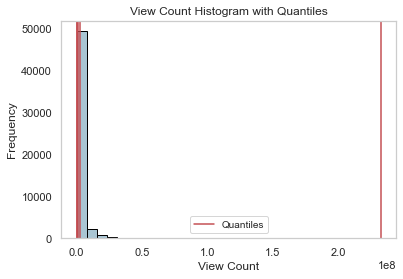

In [201]:
fig, ax = plt.subplots()
DF_DUMMY['view_count'].hist(bins=30, color='#A9C5D3', 
                             edgecolor='black', grid=False)
for quantile in quantiles:
    qvl = plt.axvline(quantile, color='r')
ax.legend([qvl], ['Quantiles'], fontsize=10)
ax.set_title('View Count Histogram with Quantiles', 
             fontsize=12)
ax.set_xlabel('View Count', fontsize=12)
ax.set_ylabel('Frequency', fontsize=12)

The data was then broken down into the 4 categories and a new column was created called "View_quantile_label".

In [202]:
quantile_labels = ['0-25Q', '25-50Q', '50-75Q', '75-100Q']
DF_DUMMY['View_quantile_range'] = pd.qcut(
                                            DF_DUMMY['view_count'], 
                                            q=quantile_list)
DF_DUMMY['View_quantile_label'] = pd.qcut(
                                            DF_DUMMY['view_count'], 
                                            q=quantile_list,       
                                            labels=quantile_labels)

DF_DUMMY[['view_count','view_count_log', 'View_quantile_range', 
               'View_quantile_label']].iloc[4:9]

,view_count,view_count_log,View_quantile_range,View_quantile_label
4,1123889,13.932306,"(547115.0, 1127988.0]",25-50Q
5,949491,13.763681,"(547115.0, 1127988.0]",25-50Q
6,470446,13.061436,"(38509.999, 547115.0]",0-25Q
7,1050143,13.864437,"(547115.0, 1127988.0]",25-50Q
8,1402687,14.153900,"(1127988.0, 2516799.0]",50-75Q


In the last section, we did everything on a Pandas dataframe. We now tried to do the same on the Spark dataframe so that the ML can be run efficiently.

In [98]:
bucketizer = Bucketizer(splits=[38510,  547115, 1127988, 2516799, 232649205], inputCol='view_count', outputCol='view_count_category') #categorizing view data

#Pipeline Stages
stages = [bucketizer]
pipeline = Pipeline(stages=stages)

In [99]:
df_Main = pipeline.fit(df_Main).transform(df_Main) # fit the pipeline model and transform the data

In [100]:
df_Main.show(5)

+-----------+--------------------+-------------------+--------------------+-------------+----------+-------------+--------------------+----------+------+--------+-------------+--------------------+-----------------+----------------+----+--------+------------------+------------------+------------------+---------+--------------+------------------------+-----------------------+-------------------+
|   video_id|               title|        publishedAt|           channelId| channelTitle|categoryId|trending_date|                tags|view_count| likes|dislikes|comment_count|      thumbnail_link|comments_disabled|ratings_disabled|hour|datediff|    view_count_log| comment_count_log|         likes_log|wordCount|  categoryName|comments_disabled_binary|ratings_disabled_binary|view_count_category|
+-----------+--------------------+-------------------+--------------------+-------------+----------+-------------+--------------------+----------+------+--------+-------------+--------------------+-------

## Random Forest Classifier
We use random forest classifier to run the model. First, we ssemble all the features with VectorAssembler.

In [101]:
required_features = ['comments_disabled_binary',
                    'ratings_disabled_binary',
                    'wordCount',
                    'hour']

assembler = VectorAssembler(inputCols=required_features, outputCol='features')
transformed_data = assembler.transform(df_Main)

In [102]:
transformed_data.show(5)

+-----------+--------------------+-------------------+--------------------+-------------+----------+-------------+--------------------+----------+------+--------+-------------+--------------------+-----------------+----------------+----+--------+------------------+------------------+------------------+---------+--------------+------------------------+-----------------------+-------------------+-------------------+
|   video_id|               title|        publishedAt|           channelId| channelTitle|categoryId|trending_date|                tags|view_count| likes|dislikes|comment_count|      thumbnail_link|comments_disabled|ratings_disabled|hour|datediff|    view_count_log| comment_count_log|         likes_log|wordCount|  categoryName|comments_disabled_binary|ratings_disabled_binary|view_count_category|           features|
+-----------+--------------------+-------------------+--------------------+-------------+----------+-------------+--------------------+----------+------+--------+--

Next, we split between testing and training. Then, we evaluate our model.

In [103]:
(training_data, test_data) = transformed_data.randomSplit([0.8,0.2])

Creating the model

In [104]:
rf_class = RandomForestClassifier(labelCol='view_count_category', 
                            featuresCol='features',
                            maxDepth=5)

In [105]:
model_class = rf_class.fit(training_data)

In [106]:
predictions = model_class.transform(test_data)

In [107]:
evaluator = MulticlassClassificationEvaluator(
    labelCol='view_count_category', 
    predictionCol='prediction', 
    metricName='accuracy')

As this is a classification model. We will be using accuracy score to evaluate the model. Accuracy score of this model is 0.3127.

In [108]:
accuracy = evaluator.evaluate(predictions)
print('Test Accuracy = ', accuracy)

Test Accuracy =  0.3127383676582761


## Conclusion


Music and Entertainment are the two categories that dominate the top trending videos on Youtube between August 2020 and April 2021. There is a positive correlation between the number of views and likes that a trending video gains, which in turn may impact how these videos are curated to gain the maximum amount of revenue, based on the two aspects and others such as titles, comments, ratings, and tags on how a trending video circulates among the Youtube community.

After testing different models, we can conclude that Random Forest would be better the model to use to predict the number of views. Random Forest Regression model that used log view had a better r^2 and RMSE score. The accuracy score of random forest classfication model is 0.31. The scores from both regression and classification model is pretty low. To improve the model we do hyperparameter tuning and test with different values to improve numbers used for evaluation.